# Solving Gravitational Orbits in Cartesian Coordinates

Defines a GravitationOrbits class that solves the two-body problem for gravitational attraction between two bodies in Cartesian coordinates.

By Karish Seebaluck (seebaluck.1@osu.edu)

In [1]:
%matplotlib inline

import numpy as np
from scipy.integrate import solve_ivp

import matplotlib.pyplot as plt
from IPython.display import Image

from matplotlib import animation, rc
from IPython.display import HTML

In [2]:
Image(url='https://www.vedantu.com/question-sets/78e533e9-b754-427a-860d-a8c795de89b4101132356443975789.png')

The gravitation force between two objects is given by,<p>
<center>$\vec{F}_{21} = \large\frac{-Gm_{1}m_{2}}{|\vec{r}_{21}|^{2}}\hat{r}_{21}$<p>

where $\hat{r}$ is the unit seperation vector between the two objects and the denominator is simply the distance between the two. Our seperation vector and unit vector is given by,<p>
<center>$\vec{r}_{21} = \vec{r}_{2} - \vec{r}_{1}$<p>
<center>$\hat{r}_{21} = \large\frac{\vec{r}_{2} - \vec{r}_{1}}{|\vec{r}_{2} - \vec{r}_{1}|}$<p>
Then by Newton's Third Law,<p>
<center>$\vec{F}_{12} = \large\frac{Gm_{1}m_{2}}{|\vec{r}_{12}|^{2}}\hat{r}_{12}$<p>
Where the vectors follow a similar convention as above. Then our differential equations of motion will be given by,<p>
<center>$\ddot{\vec{r}}_{21} = \large\frac{-Gm_{1}}{|\vec{r}_{21}|^{3}}\vec{r}_{21}$<p>
<center>$\ddot{\vec{r}}_{12} = \large\frac{-Gm_{2}}{|\vec{r}_{21}|^{3}}\vec{r}_{12}$<p>
Then in cartesian coordinates, our equations are going to be,<p>
<center>$\ddot{x}_{2}=\large\frac{-Gm_{1}}{[(x_{2}-x_{1})^{2} + (y_{2}-y_{1})^{2}]^{\frac{3}{2}}}(x_{2}-x_{1})$<p>
<center>$\ddot{x}_{1}=\large\frac{Gm_{2}}{[(x_{2}-x_{1})^{2} + (y_{2}-y_{1})^{2}]^{\frac{3}{2}}}(x_{2}-x_{1})$<p>
<center>$\ddot{y}_{2}=\large\frac{-Gm_{1}}{[(x_{2}-x_{1})^{2} + (y_{2}-y_{1})^{2}]^{\frac{3}{2}}}(y_{2}-y_{1})$<p>

<center>$\ddot{y}_{1}=\large\frac{Gm_{2}}{[(x_{2}-x_{1})^{2} + (y_{2}-y_{1})^{2}]^{\frac{3}{2}}}(y_{2}-y_{1})$<p>

In [3]:
class GravityOrbits():
    """
    This class solves for the motion of two objects exerting gravitational
    force on each other.
    
    Parameters
    ----------
    G : float
        Gravitational Constant
    m_1 : float
        Mass of one object
    m_2 : float
        Mass of the other object
        
    Methods
    -------
    dy_dt(t, y)
        Returns the right side of the differential equation in multiple component vector y,
        given time t and the corresponding value of y.
    """
    def __init__(self, G=1, m_1=1, m_2=1):
        self.G = G
        self.m_1 = m_1
        self.m_2 = m_2
    
    def dz_dt(self, t, z):
        """
        This function returns the right-hand side of the diff eq,
        [dz/dt, dz^2/dt^2]
        
        Parameters
        ----------
        t : float
            time
        z : list with floats
            An 8-component vector with the following layout
            z[0] = x1, z[1] = x1_dot
            z[2] = y1, z[3] = y1_dot
            z[4] = x2, z[5] = x2_dot
            z[6] = y2, z[7] = y2_dot
        Returns
        -------
        This function returns the right-hand side our diff eqs
        """
        r = np.sqrt((z[4] - z[0])**2 + (z[6] - z[2])**2)
        finalvec = []
        finalvec.append(z[1])
        finalvec.append(self.G * self.m_2 * (z[4] - z[0]) / r**3)
        finalvec.append(z[3])
        finalvec.append(self.G * self.m_2 * (z[6] - z[2]) / r**3)
        finalvec.append(z[5])
        finalvec.append(-self.G * self.m_1 * (z[4] - z[0]) / r**3)
        finalvec.append(z[7])
        finalvec.append(-self.G * self.m_1 * (z[6] - z[2]) / r**3)
        
        return finalvec
        
    def solve_ode(self, t_pts, z, abserr=1.0e-10, relerr=1.0e-10):
        """
        Solve the ODE given initial conditions.
        Specify smaller abserr and relerr to get more precision.
        """
        solution = solve_ivp(self.dz_dt, (t_pts[0], t_pts[-1]), 
                             z, t_eval=t_pts, method='RK23', atol=abserr, rtol=relerr)
        x1, x1_dot, y1, y1_dot, x2, x2_dot, y2, y2_dot = solution.y
        
        return x1, x1_dot, y1, y1_dot, x2, x2_dot, y2, y2_dot

In [4]:
def plot_y_vs_x(x, y, axis_labels=None, label=None, title=None, 
                color=None, linestyle=None, semilogy=False, loglog=False,
                ax=None):
    """
    Generic plotting function: return a figure axis with a plot of y vs. x,
    with line color and style, title, axis labels, and line label
    """
    if ax is None:        # if the axis object doesn't exist, make one
        ax = plt.gca()

    if (semilogy):
        line, = ax.semilogy(x, y, label=label, 
                            color=color, linestyle=linestyle)
    elif (loglog):
        line, = ax.loglog(x, y, label=label, 
                          color=color, linestyle=linestyle)
    else:
        line, = ax.plot(x, y, label=label, 
                    color=color, linestyle=linestyle)

    if label is not None:    # if a label if passed, show the legend
        ax.legend()
    if title is not None:    # set a title if one if passed
        ax.set_title(title)
    if axis_labels is not None:  # set x-axis and y-axis labels if passed  
        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])

    return ax, line

def start_stop_indices(t_pts, plot_start, plot_stop):
    start_index = (np.fabs(t_pts-plot_start)).argmin()  # index in t_pts array 
    stop_index = (np.fabs(t_pts-plot_stop)).argmin()  # index in t_pts array 
    return start_index, stop_index

In [5]:
def comcalc(d1,d2,m_1,m_2):
    """
    Calculates the COM along one axis given the masses and coordinates
    """
    return ((d1 * m_1) + (d2 * m_2)) / (m_1 + m_2)

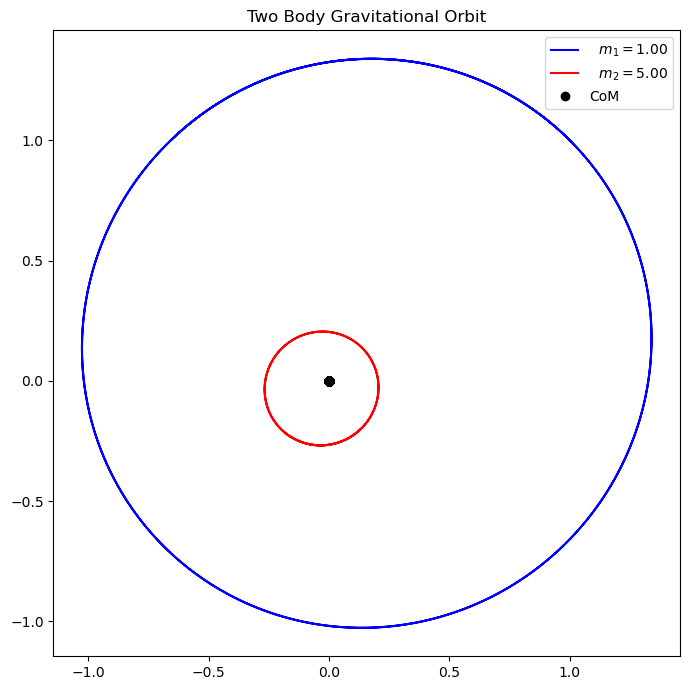

In [6]:
m_1 = 1
m_2 = 5
t_start = 0.
t_end = 10.
delta_t = 0.01
t_pts = np.arange(t_start, t_end+delta_t, delta_t)

# Initializing our system with a stationary CoM so the orbits are apparent
twobody1 = GravityOrbits(G=1,m_1=m_1,m_2=m_2)
x10 = 1.
x1dot0 = -1.
y10 = 1.
y1dot0 = 1.
x20 = -(m_1 / m_2) * x10
x2dot0 = -(m_1 / m_2) * x1dot0
y20 = -(m_1 / m_2) * y10
y2dot0 = -(m_1 / m_2) * y1dot0

z = [x10, x1dot0, y10, y1dot0, x20, x2dot0, y20, y2dot0]

x1, x1_dot, y1, y1_dot, x2, x2_dot, y2, y2_dot = twobody1.solve_ode(t_pts, z)

#Plotting our data
orbit_labels = (r'$x$',r'$y$')

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(1,1,1)
ax.plot(x1,y1, color='blue', label=rf'  $m_1 = {m_1:.2f}$')
ax.plot(x2,y2, color='red', label=rf'  $m_2 = {m_2:.2f}$')
ax.plot(comcalc(x1,x2,m_1,m_2),comcalc(y1,y2,m_1,m_2),'o', color='black', label='CoM')
ax.set_title('Two Body Gravitational Orbit')
ax.legend()
fig.tight_layout()

With the parameters specified above, we get the following plot. As expected, our center of mass is orbiting much closer to our larger mass $m_{2}$. The mass $m_{1}$ orbits much further out. With these initial conditions, our center of mass is stationary. Both of our masses are orbiting the center of mass.

In [7]:
def orbit_animation(n):
    """
    This function is used by FuncAnimation to create n frames
    """
    pt1_anim.set_data(x1[n], y1[n])
    pt2_anim.set_data(x2[n], y2[n])
    
    return (pt1_anim, pt2_anim)

In [8]:
%%capture

x_min = -1.5
x_max = 1.5
y_min = -1.5
y_max = 1.5

#Setting up the animation figure
fig_anim = plt.figure(figsize=(5,5))
ax_anim = fig_anim.add_subplot(1,1,1)
ax_anim.set_xlim(x_min,x_max)
ax_anim.set_ylim(y_min,y_max)

#Unlike the pendulum, we only need two lines and points here
ptcm_anim, = ax_anim.plot(comcalc(x1,x2,m_1,m_2),comcalc(y1,y2,m_1,m_2),'o', color='black')
pt1_anim, = ax_anim.plot(x1[0],y1[0],'o', color='blue')
pt2_anim, = ax_anim.plot(x2[0],y2[0],'o', color='red')
ln1_anim, = ax_anim.plot(x1,y1, color='blue')
ln2_anim, = ax_anim.plot(x2,y2, color='red')

fig_anim.tight_layout()

In [9]:
anim = animation.FuncAnimation(fig_anim,
                               orbit_animation,
                               init_func=None,
                               frames=500,
                               interval=20,
                               blit=True,
                               repeat=False)

HTML(anim.to_jshtml())

This animation is very interesting. The larger mass is orbiting much slower than the outer mass. It is also always aligned to be as far away from the smaller mass as possible. This is very reminiscent of the Pluto-Charon orbit.

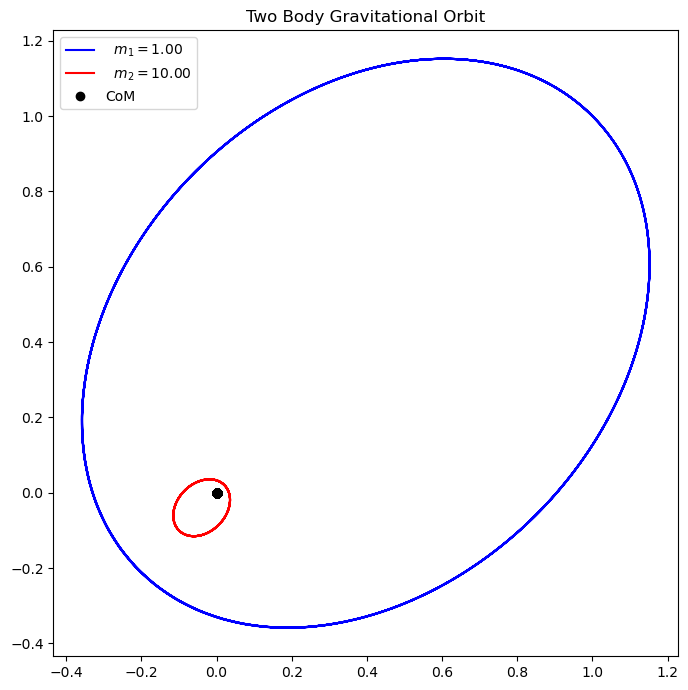

In [10]:
m_1 = 1
m_2 = 10
t_start = 0.
t_end = 10.
delta_t = 0.01
t_pts = np.arange(t_start, t_end+delta_t, delta_t)

# Initializing our system with a stationary CoM so the orbits are apparent
twobody1 = GravityOrbits(G=1,m_1=m_1,m_2=m_2)
x10 = 1.
x1dot0 = -1.
y10 = 1.
y1dot0 = 1.
x20 = -(m_1 / m_2) * x10
x2dot0 = -(m_1 / m_2) * x1dot0
y20 = -(m_1 / m_2) * y10
y2dot0 = -(m_1 / m_2) * y1dot0

z = [x10, x1dot0, y10, y1dot0, x20, x2dot0, y20, y2dot0]

x1, x1_dot, y1, y1_dot, x2, x2_dot, y2, y2_dot = twobody1.solve_ode(t_pts, z)

#Plotting our data
orbit_labels = (r'$x$',r'$y$')

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(1,1,1)
ax.plot(x1,y1, color='blue', label=rf'  $m_1 = {m_1:.2f}$')
ax.plot(x2,y2, color='red', label=rf'  $m_2 = {m_2:.2f}$')
ax.plot(comcalc(x1,x2,m_1,m_2),comcalc(y1,y2,m_1,m_2),'o', color='black', label='CoM')
ax.set_title('Two Body Gravitational Orbit')
ax.legend()
fig.tight_layout()

For this case, we have increased the mass of $m_{2}$ to be 10 times larger than $m_{1}$. We also kept the same initial positions and velocities. The center of mass is now even closer to our larger mass. Although, due to the initial velocities of our masses, their orbits are elliptical. We expect the masses to move faster as they get closer to the center of mass.

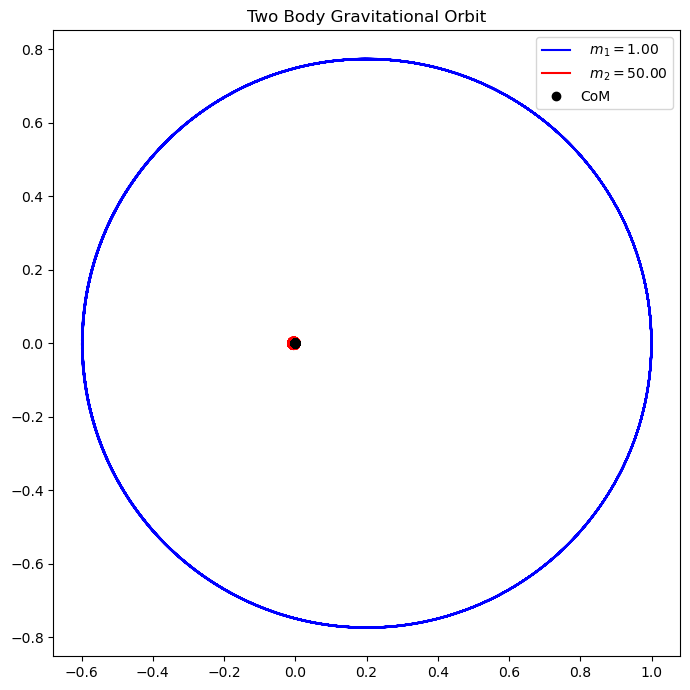

In [11]:
m_1 = 1
m_2 = 50
t_start = 0.
t_end = 10.
delta_t = 0.01
t_pts = np.arange(t_start, t_end+delta_t, delta_t)

# Initializing our system with a stationary CoM so the orbits are apparent
twobody1 = GravityOrbits(G=1,m_1=m_1,m_2=m_2)
x10 = 1.
x1dot0 = 0
y10 = 0
y1dot0 = 6
x20 = -(m_1 / m_2) * x10
x2dot0 = -(m_1 / m_2) * x1dot0
y20 = -(m_1 / m_2) * y10
y2dot0 = -(m_1 / m_2) * y1dot0

z = [x10, x1dot0, y10, y1dot0, x20, x2dot0, y20, y2dot0]

x1, x1_dot, y1, y1_dot, x2, x2_dot, y2, y2_dot = twobody1.solve_ode(t_pts, z)

#Plotting our data
orbit_labels = (r'$x$',r'$y$')

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(1,1,1)
ax.plot(x1,y1, color='blue', label=rf'  $m_1 = {m_1:.2f}$')
ax.plot(x2,y2, color='red', label=rf'  $m_2 = {m_2:.2f}$')
ax.plot(comcalc(x1,x2,m_1,m_2),comcalc(y1,y2,m_1,m_2),'o', color='black', label='CoM')
ax.set_title('Two Body Gravitational Orbit')
ax.legend()
fig.tight_layout()

For this case, I increased the mass even higher. Now with a mass of 50 times $m_{1}$, our second mass is practically on top of our center of mass. Our orbit is even closer to being circular, but again, due to the initial conditions is it slightly elliptical. This is very similar to the cases we looked at in class, where a very massive object has a much smaller object orbiting it. This is a bounded orbit where the heavier mass is at one of the foci of the ellipse. 

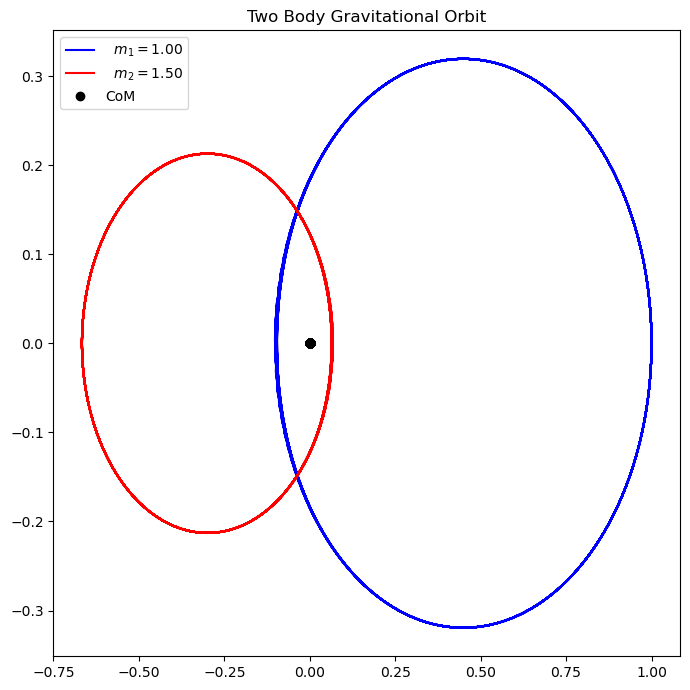

In [12]:
m_1 = 1
m_2 = 1.5
t_start = 0.
t_end = 20.
delta_t = 0.01
t_pts = np.arange(t_start, t_end+delta_t, delta_t)

# Initializing our system with a stationary CoM so the orbits are apparent
twobody1 = GravityOrbits(G=10,m_1=m_1,m_2=m_2)
x10 = 1
x1dot0 = 0
y10 = 0
y1dot0 = 1
x20 = -(m_1 / m_2) * x10
x2dot0 = -(m_1 / m_2) * x1dot0
y20 = -(m_1 / m_2) * y10
y2dot0 = -(m_1 / m_2) * y1dot0

z = [x10, x1dot0, y10, y1dot0, x20, x2dot0, y20, y2dot0]

x1, x1_dot, y1, y1_dot, x2, x2_dot, y2, y2_dot = twobody1.solve_ode(t_pts, z)

#Plotting our data
orbit_labels = (r'$x$',r'$y$')

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(1,1,1)
ax.plot(x1,y1, color='blue', label=rf'  $m_1 = {m_1:.2f}$')
ax.plot(x2,y2, color='red', label=rf'  $m_2 = {m_2:.2f}$')
ax.plot(comcalc(x1,x2,m_1,m_2),comcalc(y1,y2,m_1,m_2),'o', color='black', label='CoM')
ax.set_title('Two Body Gravitational Orbit')
ax.legend()
fig.tight_layout()

The plot above is going to be the orbit that we will be animating. This one is a great candidate for animation as it will really show the variability of speeds in these orbits.

In [13]:
%%capture

x_min = -1.5
x_max = 1.5
y_min = -1.5
y_max = 1.5

#Setting up the animation figure
fig_anim = plt.figure(figsize=(5,5))
ax_anim = fig_anim.add_subplot(1,1,1)
ax_anim.set_xlim(x_min,x_max)
ax_anim.set_ylim(y_min,y_max)

#Unlike the pendulum, we only need two lines and points here
ptcm_anim, = ax_anim.plot(comcalc(x1,x2,m_1,m_2),comcalc(y1,y2,m_1,m_2),'o', color='black')
pt1_anim, = ax_anim.plot(x1[0],y1[0],'o', color='blue')
pt2_anim, = ax_anim.plot(x2[0],y2[0],'o', color='red')
ln1_anim, = ax_anim.plot(x1,y1, color='blue')
ln2_anim, = ax_anim.plot(x2,y2, color='red')

fig_anim.tight_layout()

In [14]:
anim = animation.FuncAnimation(fig_anim,
                               orbit_animation,
                               init_func=None,
                               frames=500,
                               interval=20,
                               blit=True,
                               repeat=False)

HTML(anim.to_jshtml())

The animation is just as we expected. The mass of the two objects are very close to each other, so their orbits are fairly similar. Although, since $m_{2}$ is slight bigger, it gets closer to the center of mass. Interestingly, the masses their periapsis at the same exact time. So the smaller mass must be moving much faster.